In [19]:
import matplotlib.pyplot as plt
%matplotlib inline
import torch
import torch.nn.functional as F
import math

In [2]:
words = open('names.txt').read().splitlines()

In [3]:
chars = sorted(list(set([c for w in words for c in w])))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0

In [4]:
itos = {i:s for s,i in stoi.items()}

In [5]:
# Exercise 1: build a simple bigram model for next-character prediction
# - store the co-counts of each character in a 27x27 matrix N
# - compute the normalized probabilities into a matrix P
# - generate a bunch of samples from the model using P and torch.multinomial

In [27]:
N = torch.zeros((27,27), dtype=torch.int32)
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 = stoi[ch2]
        N[ix1, ix2] += 1

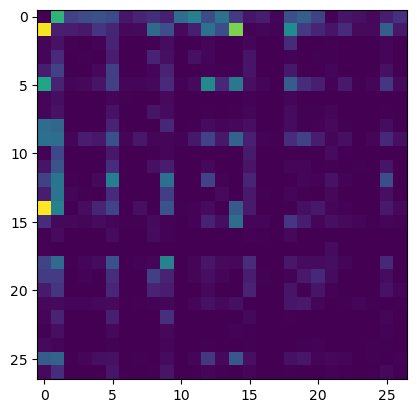

In [28]:

plt.imshow(N)
plt.show()

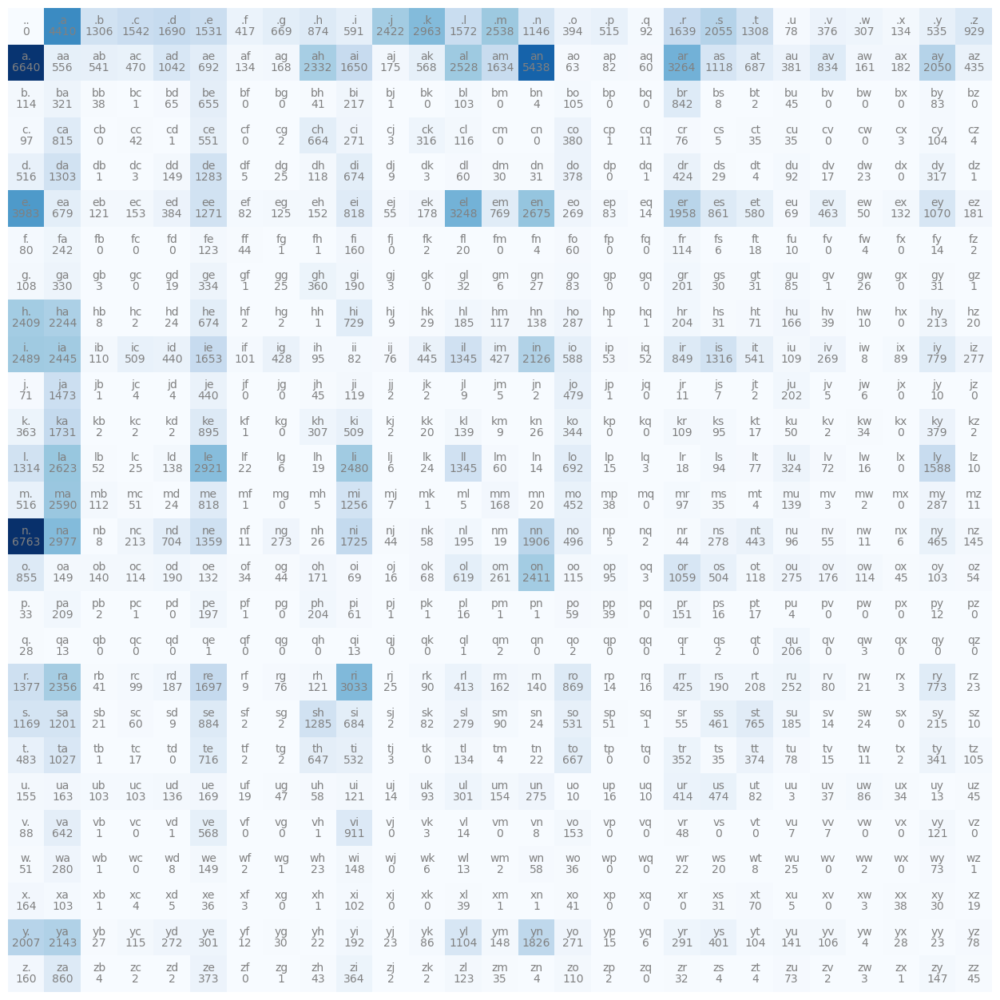

In [29]:
plt.figure(figsize=(16,16))
plt.imshow(N, cmap='Blues')
for i in range(27):
    for j in range(27):
        chstr = itos[i] + itos[j]
        plt.text(j, i, chstr, ha="center", va="bottom", color='gray')
        plt.text(j, i, N[i, j].item(), ha="center", va="top", color='gray')
plt.axis('off')
plt.show()

In [30]:
# useful to reproduce results
g = torch.Generator().manual_seed(2147483647)

In [31]:
P = N.float()
P = P / P.sum(1, keepdim=True)

In [42]:
g = torch.Generator().manual_seed(2147483647)
for _ in range(30):
    ix = 0
    out = []
    while True:
        p = P[ix]
        ix = torch.multinomial(p, num_samples=1, replacement=True, generator=g).item()
        out.append(itos[ix])
        if ix == 0:
            break
    print(''.join(out))

cexze.
momasurailezitynn.
konimittain.
llayn.
ka.
da.
staiyaubrtthrigotai.
moliellavo.
ke.
teda.
ka.
emimmsade.
enkaviyny.
ftlspihinivenvorhlasu.
dsor.
br.
jol.
pen.
aisan.
ja.
feniee.
zem.
deru.
firit.
gaikajahahbevare.
kiysthelenaririenah.
keen.
x.
al.
kal.


In [12]:
# Exercise 2: build the same bigram model using the NLL loss
# - the dataset is created and encoded for you
# - create the weights matrix W
# - build a training loop to minimize the NLL
# - sample from the model

In [13]:
# create a training set for bigram model
# 
xs = []
ys = []
for w in words:
    chs = ['.'] + list(w) + ['.']
    for ch1, ch2 in zip(chs, chs[1:]):
        ix1 = stoi[ch1]
        ix2 = stoi[ch2]
        xs.append(ix1)
        ys.append(ix2)
xs = torch.tensor(xs)
ys = torch.tensor(ys)
num = xs.nelement()

In [14]:
import torch.nn.functional as F

In [15]:
g = torch.Generator().manual_seed(2147483647)
W = torch.randn((27,27), generator=g)
W.requires_grad=True

In [17]:
for k in range(2000):
    #forward pass
    xenc = F.one_hot(xs, num_classes=27).float()
    logits = xenc @ W
    counts = logits.exp()
    probs = counts / counts.sum(1, keepdim=True)
    loss = -probs[torch.arange(num), ys].log().mean()# + 0.1 * (W**2).mean()

    # backward pass
    W.grad = None
    loss.backward()

    # update
    lmbda = 50
    W.data += -lmbda * W.grad

    print(k, loss.item())

0 2.5032501220703125
1 2.501070499420166
2 2.499196767807007
3 2.497532367706299
4 2.4960296154022217
5 2.4946579933166504
6 2.4933955669403076
7 2.4922261238098145
8 2.491137981414795
9 2.4901204109191895
10 2.4891653060913086
11 2.488267183303833
12 2.4874188899993896
13 2.486616849899292
14 2.485856294631958
15 2.4851338863372803
16 2.4844470024108887
17 2.4837920665740967
18 2.4831666946411133
19 2.4825692176818848
20 2.4819977283477783
21 2.481449842453003
22 2.480924606323242
23 2.480419874191284
24 2.4799351692199707
25 2.479468822479248
26 2.4790194034576416
27 2.4785869121551514
28 2.4781692028045654
29 2.477766275405884
30 2.477376937866211
31 2.4770004749298096
32 2.4766366481781006
33 2.4762847423553467
34 2.4759435653686523
35 2.4756128787994385
36 2.475292444229126
37 2.4749815464019775
38 2.474679708480835
39 2.474386692047119
40 2.4741017818450928
41 2.473825216293335
42 2.47355580329895
43 2.473294258117676
44 2.473039150238037
45 2.4727911949157715
46 2.47254967689514

KeyboardInterrupt: 

In [44]:
torch.tensor(27).log()

tensor(3.2958)

In [ ]:
# finally, sample from the neural net model
g = torch.Generator().manual_seed(2147483647)

for k in range(10):
    out = []
    ix = 0
    for _ in range(10):
        x = F.one_hot(torch.tensor([ix]), num_classes=27).float()
        logits = x @ W
        counts = logits.exp()
        probs = counts / counts.sum(1, keepdim=True)
        ix = probs.multinomial(num_samples=1, replacement=True, generator=g).item()
        if ix == 0:
            break
        out.append(itos[ix])
    print(''.join(out))

cexze
momakurail
azityha
konimittai
n
llayn
ka
da
staiyaubja
bhrigotai


In [ ]:
# Exercise 3: homework (*) extend the previous model to trigram

In [ ]:
# create the dataset (trigram model)
xs, ys = [], []
for w in words:
  chs = ['.'] + list(w) + ['.']
  for ch1, ch2, ch3 in zip (chs, chs[1:], chs[2:]):
    #print(ch1,ch2,ch3)
    ix1 = stoi[ch1]
    ix2 = stoi[ch2]
    ix3 = stoi[ch3]
    xs.append([ix1,ix2])
    ys.append(ix3)
xs = torch.tensor(xs)
ys = torch.tensor(ys)
num = xs.shape[0]
print(f'num examples = {num}')

# initialize the network
g = torch.Generator().manual_seed(2147483647)
W = torch.rand(27, 27, 27, generator=g)
W.requires_grad = True

num examples = 196113


In [ ]:
# split into train/dev/test
a = int(.8 * num)
b = int(.9 * num)
xs_train = xs[:a,:]
xs_dev = xs[a:b,:]
xs_test = xs[b:,:]
ys_train = ys[:a]
ys_dev = ys[a:b]
ys_test = ys[b:]
num_train = xs_train.shape[0]
num_dev = xs_dev.shape[0]
print(f'train samples = {num_train} / {num}')

train samples = 156890 / 196113


In [ ]:
train_loss = []
dev_loss = []
lr = 1.0

# gradient descent
for k in range(2000):

  # forward pass
  xenc = F.one_hot(xs_train, num_classes=27).float()
  logits = torch.einsum('bik,kjl->bil', xenc, W)  # [bs, 2, 27]
  probs = F.softmax(logits, dim=2)
  probs = probs[torch.arange(0, num_train), :, ys_train]
  loss = - torch.mean(torch.log(probs))
  
  # backward pass
  W.grad = None
  loss.backward()

  # update
  W.data -= lr * W.grad

  print(k, loss.item())
  train_loss.append(loss.item())

  with torch.no_grad():
    if k % 100 == 0:
      # dev loss
      xenc = F.one_hot(xs_dev, num_classes=27).float()
      logits = torch.einsum('bik,kjl->bil', xenc, W)  # [bs, 2, 27]
      probs = F.softmax(logits, dim=2)
      probs = probs[torch.arange(0, num_dev), :, ys_dev]
      loss_dev = - torch.mean(torch.log(probs))
      print(f'\ttrain loss, dev loss = {loss.item()}, {loss_dev.item()}')
      train_loss.append(loss.item())
      dev_loss.append(loss_dev.item())

print("Mean of training loss: ", sum(train_loss)/len(train_loss))
print("Mean of dev set loss: ", sum(dev_loss)/len(dev_loss))
print("----------------------------")


0 4.2359232902526855
	train loss, dev loss = 4.2359232902526855, 3.959491729736328
1 3.9364631175994873
2 3.72186017036438
3 3.5554089546203613
4 3.427952766418457
5 3.3304433822631836
6 3.2538251876831055
7 3.191235065460205
8 3.1381337642669678
9 3.092017412185669
10 3.0515408515930176
11 3.0158486366271973
12 2.9842896461486816
13 2.956315755844116
14 2.931445837020874
15 2.9092583656311035
16 2.889389991760254
17 2.8715293407440186
18 2.855412244796753
19 2.8408124446868896
20 2.8275349140167236
21 2.8154067993164062
22 2.80427885055542
23 2.794018268585205
24 2.784510612487793
25 2.7756590843200684
26 2.767380952835083
27 2.7596094608306885
28 2.7522871494293213
29 2.7453701496124268
30 2.738819122314453
31 2.7326037883758545
32 2.7266969680786133
33 2.721076250076294
34 2.71572208404541
35 2.710616111755371
36 2.705744504928589
37 2.701092004776001
38 2.6966464519500732
39 2.6923954486846924
40 2.688328981399536
41 2.684436559677124
42 2.680708169937134
43 2.6771352291107178
44 2

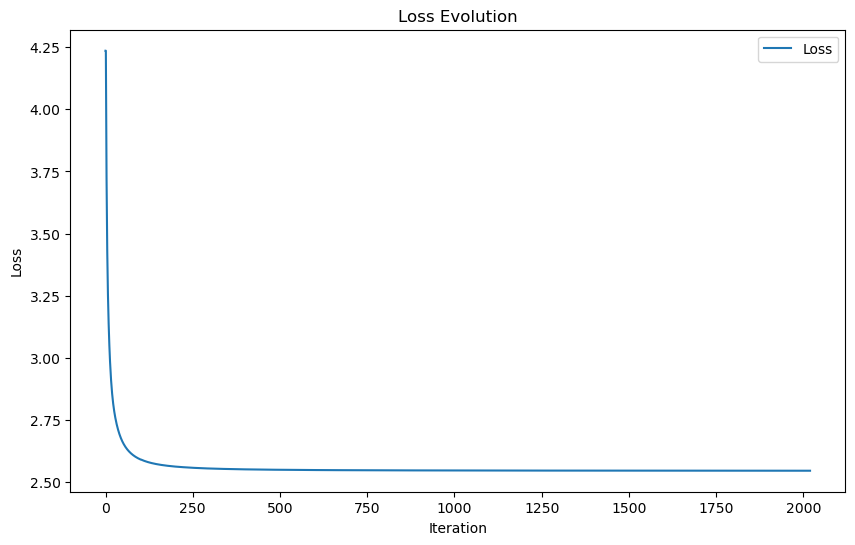

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(train_loss, label='Loss')
plt.title('Loss Evolution')
plt.xlabel('Iteration')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
# finally, sample from the neural net model
import random
g = torch.Generator().manual_seed(2147483647)

## Sampling 
for k in range(10):
    out = []
    ix_1 = stoi['.']
    ix_2 = torch.randint(0, 26, (1,)).item()
    for _ in range(10):

        x = F.one_hot(torch.tensor([ix_1, ix_2]), num_classes=27).float()  
        logits = torch.einsum('ik,kjl->l', x, W)
        probs = F.softmax(logits, dim=0)
        ix_3 = torch.multinomial(probs, 1).item()

        out.append(itos[ix_2])

        if ix_3 == 0:
            break

        ix_1 = ix_2
        ix_2 = ix_3


    print(''.join(out))

oea
jaal
qe
qain
faan
sl
co
omr
beeaisada
oe


In [ ]:
# Exercise 4: let's build a better model
# Bengio et al. 2003 MLP language model paper, https://www.jmlr.org/papers/volume3/bengio03a/bengio03a.pdf

In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
block_size = 3
def build_dataset(words):
    X, Y = [], []
    for w in words:
        context = [0] * block_size
        for ch in w + '.':
            ix = stoi[ch]
            X.append(context)
            Y.append(ix)
            context = context[1:] + [ix]

    X = torch.tensor(X)
    Y = torch.tensor(Y)
    return X, Y

import random
random.seed(42)
random.shuffle(words)
n1 = int(0.8 * len(words))
n2 = int(0.9 * len(words))

X_train, Y_train = build_dataset(words[:n1])
X_dev, Y_dev = build_dataset(words[n1:n2])
X_test, Y_test = build_dataset(words[n2:])

In [ ]:
emb_size = 200
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((27,10))
W1 = torch.randn((30, emb_size))
b1 = torch.randn(emb_size)
W2 = torch.randn((emb_size, 27))
b2 = torch.randn((1, 27))
parameters = [C, W1, b1, W2, b2]
for p in parameters:
    p.requires_grad = True


In [ ]:
# init weights
b1 = torch.nn.init.zeros_(b1)
b2 = torch.nn.init.zeros_(b2)
W1 = torch.nn.init.uniform_(W1)
W2 = torch.nn.init.uniform_(W2)

In [ ]:
stepi = []
lossi = []
lri = []

In [ ]:
for p in parameters:
    p.requires_grad = True

In [ ]:
batch_size = 32
lr_ = 1
decay_rate_ = 1e-9
for i in range(200000):
    
    # minibatch
    ix = torch.randint(0, X_train.shape[0], (batch_size,))

    # forward pass
    emb = C[X_train[ix]]
    h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train[ix])
    # backward pass
    for p in parameters:
        p.grad = None
    loss.backward()
    # update
    lr = 0.1 if i < 100000 else 0.01
    #lr_ = lr_ * (1/(1+decay_rate_ * i))
    for p in parameters:
        p.data += -lr * p.grad
    stepi.append(i)
    lossi.append(loss.log10().item())
    lri.append(lr_)
    print(i, loss)

0 tensor(9.0156, grad_fn=<NllLossBackward0>)
1 tensor(5.1302, grad_fn=<NllLossBackward0>)
2 tensor(6.3527, grad_fn=<NllLossBackward0>)
3 tensor(6.0559, grad_fn=<NllLossBackward0>)
4 tensor(4.8255, grad_fn=<NllLossBackward0>)
5 tensor(4.0665, grad_fn=<NllLossBackward0>)
6 tensor(4.7388, grad_fn=<NllLossBackward0>)
7 tensor(4.3031, grad_fn=<NllLossBackward0>)
8 tensor(3.9799, grad_fn=<NllLossBackward0>)
9 tensor(4.2212, grad_fn=<NllLossBackward0>)
10 tensor(3.8770, grad_fn=<NllLossBackward0>)
11 tensor(3.5461, grad_fn=<NllLossBackward0>)
12 tensor(3.7310, grad_fn=<NllLossBackward0>)
13 tensor(3.9816, grad_fn=<NllLossBackward0>)
14 tensor(3.6034, grad_fn=<NllLossBackward0>)
15 tensor(4.5297, grad_fn=<NllLossBackward0>)
16 tensor(3.8434, grad_fn=<NllLossBackward0>)
17 tensor(3.8831, grad_fn=<NllLossBackward0>)
18 tensor(4.3891, grad_fn=<NllLossBackward0>)
19 tensor(3.9084, grad_fn=<NllLossBackward0>)
20 tensor(4.0387, grad_fn=<NllLossBackward0>)
21 tensor(3.8523, grad_fn=<NllLossBackward0>

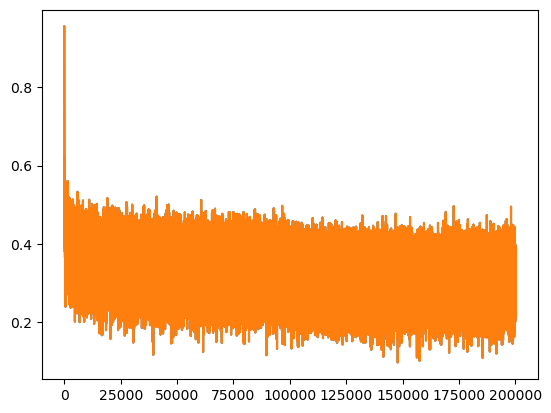

In [ ]:
plt.plot(stepi, lossi)
plt.show()

In [ ]:
# train and val loss
emb = C[X_dev]
h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
logits = h @ W2 + b2
loss = F.cross_entropy(logits, Y_dev)
print(f'val loss = {loss}')

emb = C[X_train]
h = torch.tanh(emb.view(-1, 30) @ W1 + b1)
logits = h @ W2 + b2
loss = F.cross_entropy(logits, Y_train)
print(f'train loss = {loss}')


val loss = 2.120778799057007
train loss = 2.056718587875366


In [ ]:
# results (loss dev, loss train)
# no init, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=200
2.15, 2.11
# **init uniform**, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=200
2.16, 2.05
# init uniform, batch size 32, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, **emb_size=300**
2.10, 2.05
# init uniform, **batch size 2000**, 200K steps, lr policy: lr = 0.1 if i < 100000 else 0.01, emb_size=300
2.11, 2.01
# init uniform, **batch size 2000**, 200K steps, lr policy: lr_ = lr_ * (1/(1+decay_rate_ * i)), decay_rate = 1E-9, emb_size=300
2.11, 1.98

(2.11, 1.98)

In [ ]:
# sample from the model
#g = torch.Generator().manual_seed(2147483647 + 4)

for _ in range(20):
    
    out = []
    context = [0] * block_size # initialize with all ...
    while True:
      emb = C[torch.tensor([context])] # (1,block_size,d)
      h = torch.tanh(emb.view(1, -1) @ W1 + b1)
      logits = h @ W2 + b2
      probs = F.softmax(logits, dim=1)
      ix = torch.multinomial(probs, num_samples=1, generator=g).item()
      context = context[1:] + [ix]
      out.append(ix)
      if ix == 0:
        break
    
    print(''.join(itos[i] for i in out))

ivori.
vithilee.
uzurious.
vir.
ram.
julya.
aaja.
victor.
aydenitico.
giowaideroxandie.
anay.
lillyria.
jaleighienni.
ano.
eakaelynn.
milen.
kasey.
vidahlee.
nexia.
saegesaniah.


In [ ]:
# Exercise 5 homework (*): add batchnorm to your network and report the results
# Batch norm is added between the linear layer and the non-linearity
# How many parameters does this add to your network?

In [ ]:
emb_size = 200
g = torch.Generator().manual_seed(2147483647)
C = torch.randn((27,10))
W1 = torch.randn((30, emb_size))
b1 = torch.randn(emb_size)
W2 = torch.randn((emb_size, 27))
b2 = torch.randn((1, 27))

bngains = torch.ones((1, emb_size))
bnbias = torch.zeros((1, emb_size))
bnmean_running = torch.zeros((1, emb_size))
bnstd_running = torch.ones((1, emb_size))

parameters = [C, W1, b1, W2, b2, bngains, bnbias]
for p in parameters:
    p.requires_grad = True

In [ ]:
# init weights
b1 = torch.nn.init.zeros_(b1)
b2 = torch.nn.init.zeros_(b2)
W1 = torch.nn.init.uniform_(W1)
W2 = torch.nn.init.uniform_(W2)

In [ ]:
stepi = []
lossi = []
lri = []

In [ ]:
batch_size = 32

for i in range(200000):
    
    # minibatch
    ix = torch.randint(0, X_train.shape[0], (batch_size,))

    # forward pass
    emb = C[X_train[ix]]
    hpreact = emb.view(-1, 30) @ W1 + b1

    # add batch norm
    bnmean = hpreact.mean(axis=0, keepdim=True)
    bnstdev = hpreact.std(axis=0, keepdim=True)
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    with torch.no_grad():
        bnmean_running = 0.999 * bnmean_running + 0.001 * bnmean
        bnstd_running = 0.999 * bnstd_running + 0.001 * bnstdev

    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train[ix])
    
    # backward pass
    for p in parameters:
        p.grad = None
    loss.backward()
    # update
    lr = 0.1 if i < 100000 else 0.01
    #lr_ = lr_ * (1/(1+decay_rate_ * i))
    for p in parameters:
        p.data += -lr * p.grad
    stepi.append(i)
    lossi.append(loss.log10().item())
    lri.append(lr_)
    print(i, loss)

0 tensor(6.1888, grad_fn=<NllLossBackward0>)
1 tensor(5.0237, grad_fn=<NllLossBackward0>)
2 tensor(5.0307, grad_fn=<NllLossBackward0>)
3 tensor(3.8504, grad_fn=<NllLossBackward0>)
4 tensor(3.6480, grad_fn=<NllLossBackward0>)
5 tensor(3.8631, grad_fn=<NllLossBackward0>)
6 tensor(3.4555, grad_fn=<NllLossBackward0>)
7 tensor(3.6968, grad_fn=<NllLossBackward0>)
8 tensor(3.3887, grad_fn=<NllLossBackward0>)
9 tensor(3.5581, grad_fn=<NllLossBackward0>)
10 tensor(3.2938, grad_fn=<NllLossBackward0>)
11 tensor(3.5047, grad_fn=<NllLossBackward0>)
12 tensor(3.3612, grad_fn=<NllLossBackward0>)
13 tensor(3.2901, grad_fn=<NllLossBackward0>)
14 tensor(3.1198, grad_fn=<NllLossBackward0>)
15 tensor(2.8326, grad_fn=<NllLossBackward0>)
16 tensor(3.6037, grad_fn=<NllLossBackward0>)
17 tensor(3.2350, grad_fn=<NllLossBackward0>)
18 tensor(3.2973, grad_fn=<NllLossBackward0>)
19 tensor(3.1415, grad_fn=<NllLossBackward0>)
20 tensor(3.3084, grad_fn=<NllLossBackward0>)
21 tensor(3.4967, grad_fn=<NllLossBackward0>

In [ ]:
# recompute means and bias over entire training set
with torch.no_grad():
    emb = C[X_train]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    bnmean = hpreact.mean(axis=0, keepdim=True)
    bnstdev = hpreact.std(axis=0, keepdim=True)

In [ ]:
# train and val loss 
# without batch norm: val = 2.11, train = 2.05
with torch.no_grad():
    emb = C[X_dev]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_dev)
    print(f'val loss = {loss}')

    emb = C[X_train]
    emb = emb.view(-1, 30)
    hpreact = emb @ W1 + b1
    hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
    h = torch.tanh(hpreact)
    logits = h @ W2 + b2
    loss = F.cross_entropy(logits, Y_train)
    print(f'train loss = {loss}')

val loss = 2.1449708938598633
train loss = 2.122518301010132


In [ ]:
# sample from the model
g = torch.Generator().manual_seed(2147483647 + 4)

for _ in range(20):
    
    out = []
    context = [0] * block_size # initialize with all ...
    while True:
      emb = C[torch.tensor([context])] # (1,block_size,d)
      emb = emb.view(-1, 30)
      hpreact = emb @ W1 + b1
      hpreact = bngains * (hpreact - bnmean) / bnstdev + bnbias
      h = torch.tanh(hpreact)
      logits = h @ W2 + b2
      probs = F.softmax(logits, dim=1)
      ix = torch.multinomial(probs, num_samples=1, generator=g).item()
      context = context[1:] + [ix]
      out.append(ix)
      if ix == 0:
        break
    
    print(''.join(itos[i] for i in out))

garri.
yah.
wal.
nia.
nuasa.
legaarlon.
die.
alis.
joda.
ana.
aiz.
eva.
darlen.
aitz.
caliee.
dabaet.
elyn.
aziyan.
brayla.
riter.
